Elad Inbar - 205358211 Ido Livne - 203834734 Chai Hadad - 209268135

# **Import**

In [ ]:
import csv
from torch.nn.utils.rnn import pad_sequence
import gensim
from gensim.models import Word2Vec
import torch
from torch import nn 
from torch.utils.data import Dataset, DataLoader
import torchtext
import os
import random
import pprint as pp
import math
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as pyo
from plotly.offline import init_notebook_mode, iplot
import seaborn as sns
import numpy as np
import sklearn
from sklearn import tree
from sklearn import impute
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import mean_absolute_error
from sklearn import ensemble 
import itertools
from torchtext.data import get_tokenizer
import time
import xgboost as xgb
import lightgbm as lgb
from sklearn.metrics import mean_squared_error

# **Initialize Runtime**

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
is_colab_mode = False
device


device(type='cuda')

## Google Colab Init

In [3]:
# !pip uninstall torchtext

In [4]:
# !pip install torchtext==0.8.1

In [5]:
# is_colab_mode = True

In [6]:
# import nltk
# from nltk.tokenize import sent_tokenize, word_tokenize
# !pip install -q kaggle

In [7]:
# !mkdir ~/.kaggle

In [8]:
# # Google Colab

# from google.colab import drive
# drive.mount('/content/drive')

In [9]:
# # Google Colab
# !cp -r "/content/drive/My Drive/Deep Learning/kaggle.json" "/content"

In [10]:
# !cp kaggle.json ~/.kaggle/

In [11]:
# !chmod 600 ~/.kaggle/kaggle.json

In [12]:
# !kaggle competitions download -c home-depot-product-search-relevance

In [13]:
# # Google Colab
# !cp -r "/content/drive/My Drive/Deep Learning/Assignment 4/solution.csv" "/content/solution.csv"

In [14]:
# !unzip /content/home-depot-product-search-relevance.zip

In [15]:
# Unnecessary

# !unzip /content/attributes.csv.zip
# !unzip /content/product_descriptions.csv.zip
# !unzip /content/sample_submission.csv.zip
# !unzip /content/test.csv.zip
# !unzip /content/train.csv.zip

In [16]:
# nltk.download('punkt')

# **Define dataset paths**

In [30]:
train_path = '/content/train.csv' if is_colab_mode else 'content/train.csv'
test_path = '/content/test.csv' if is_colab_mode else 'content/test.csv'
test_labels_path = '/content/solution.csv' if is_colab_mode else 'content/solution.csv'
mod_train_path = 'content/train_mod.csv'
mod_test_path = 'content/test_mod.csv'
descriptions_path = 'content/product_descriptions.csv'

# **Exploratory Data Analysis**

In [6]:
if is_colab_mode:
    # train_df = pd.read_csv(train_path + ".zip", encoding="latin-1", compression='zip')
    train_df = pd.read_csv(train_path + ".zip", encoding="ISO-8859-1", compression='zip')

else:
    train_df = pd.read_csv(train_path, encoding="ISO-8859-1")
train_df

,id,product_uid,product_title,search_term,relevance
0,2,100001,Simpson Strong-Tie 12-Gauge Angle,angle bracket,3.00
1,3,100001,Simpson Strong-Tie 12-Gauge Angle,l bracket,2.50
2,9,100002,BEHR Premium Textured DeckOver 1-gal. #SC-141 ...,deck over,3.00
3,16,100005,Delta Vero 1-Handle Shower Only Faucet Trim Ki...,rain shower head,2.33
4,17,100005,Delta Vero 1-Handle Shower Only Faucet Trim Ki...,shower only faucet,2.67
...,...,...,...,...,...
74062,221457,206638,Atlantic Windowpane 576 CD or 192 DVD Blu-Ray ...,tv riser glass,1.00
74063,221458,206639,Philips 40-Watt Halogen R20 Flood Light Bulb (...,r20 halogen light,3.00
74064,221463,206641,Schlage Camelot In-Active Aged Bronze Handlese...,schlage lock siena half dummy knob with,2.33
74065,221471,206648,Plastec 11 in. x 24 in. Rose Garden Wall Decor...,zen garden decor,3.00


In [7]:
if is_colab_mode:
    test_df =  pd.read_csv(test_path + ".zip", encoding="ISO-8859-1", compression="zip")
else:
    test_df = pd.read_csv(test_path, encoding="ISO-8859-1")
test_df

,id,product_uid,product_title,search_term
0,1,100001,Simpson Strong-Tie 12-Gauge Angle,90 degree bracket
1,4,100001,Simpson Strong-Tie 12-Gauge Angle,metal l brackets
2,5,100001,Simpson Strong-Tie 12-Gauge Angle,simpson sku able
3,6,100001,Simpson Strong-Tie 12-Gauge Angle,simpson strong ties
4,7,100001,Simpson Strong-Tie 12-Gauge Angle,simpson strong tie hcc668
...,...,...,...,...
166688,240756,224424,stufurhome Norma 24 in. W x 16 in. D x 34 in. ...,24 whtie storage cabinet
166689,240757,224425,Home Decorators Collection 49 in. D Alessandro...,adirondeck cusion
166690,240758,224426,Simpson Strong-Tie HB 3-1/2 x 14 in. Top Flang...,hb
166691,240759,224427,1/4 in. -20 tpi x 1-1/2 in. Stainless Steel Bu...,hex sockets


## Plots Functions

In [8]:
def plot_relevance_score_distribution(df, df_name):
    sns.displot(df['relevance'], kde=False, bins=20)
    plt.xlabel('Relevance Score')
    plt.ylabel('Count')
    plt.title(f'{df_name} Relevance Score Distribution')
    plt.show()

In [9]:
def plot_word_length_distribution(df, df_name, column, x_title):
    df[column + '_length'] = df[column].apply(lambda x: len(x.split()))
    fig = px.histogram(df, x=column+"_length")
    fig.update_layout(
        title=dict(text=f'{df_name} - {x_title} By Word Length Distribution', font=dict(size=20)),
        xaxis_title=x_title+" Length",
        yaxis_title="Count",
    )
    fig.show()

def plot_characters_length_distribution(df, df_name, column, x_title):
    df[column + '_length'] = df[column].apply(lambda x: len(x))
    fig = px.histogram(df, x=column + "_length")
    fig.update_layout(
        title=dict(text=f'{df_name} - {x_title} By Character Length Distribution', font=dict(size=20)),
        xaxis_title=x_title + " Length",
        yaxis_title="Count",
    )
    fig.show()

In [10]:
def calculate_product_frequency(df, col):
    freq = df.groupby('product_uid').size().reset_index(name='freq')
    # Calculate the mean, min, and max frequency of each product UID
    mean_freq = freq['freq'].mean()
    min_freq = freq['freq'].min()
    max_freq = freq['freq'].max()
    return {'Mean': mean_freq, 'Min': min_freq, 'Max': max_freq}

In [11]:
def plot_loss(epochs, df, title , use_val = True ):

    # create the first trace (scatter plot)
    trace1 = go.Scatter(x=epochs, y=df['train_loss'], mode='lines',  name='train loss')
    if use_val:

        # create the second trace (line plot)
        trace2 = go.Scatter(x=epochs, y=df['val_loss'], mode='lines',  name='validation loss')

        # create the plotly figure object
        fig = go.Figure(data=[trace1, trace2])
    else:
        fig = go.Figure(data=[trace1, trace2])

    # set the plot title and axis labels
    fig.update_layout(
        title=title,
        xaxis_title='Epochs',
        yaxis_title='Loss Value'
    )

    # display the plot
    fig.show()

## Analysis Plots

### Train Analysis

In [12]:
freq = calculate_product_frequency(train_df, 'product_uid')
print('Product UID frequency:')
print('Mean: {}'.format(freq['Mean']))
print('Min: {}'.format(freq['Min']))
print('Max: {}'.format(freq['Max']))

Product UID frequency:
Mean: 1.3548758849031408
Min: 1
Max: 21


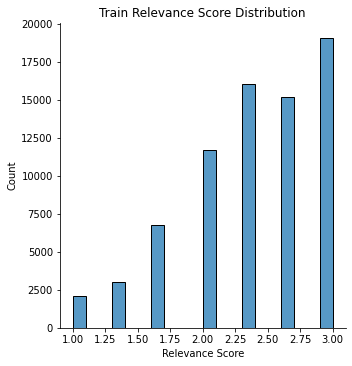

In [13]:
plot_relevance_score_distribution(train_df, 'Train')

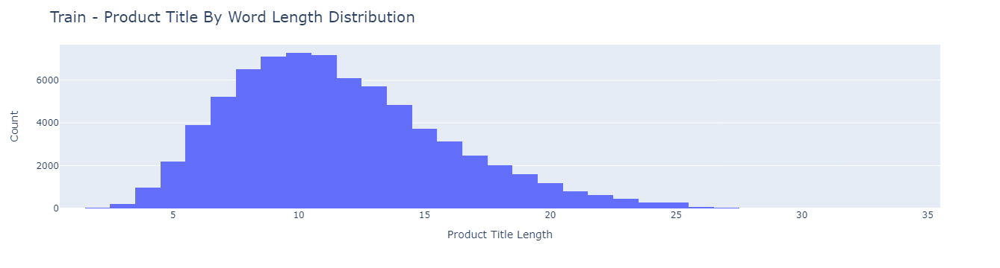

In [14]:
plot_word_length_distribution(train_df, 'Train', 'product_title', "Product Title")

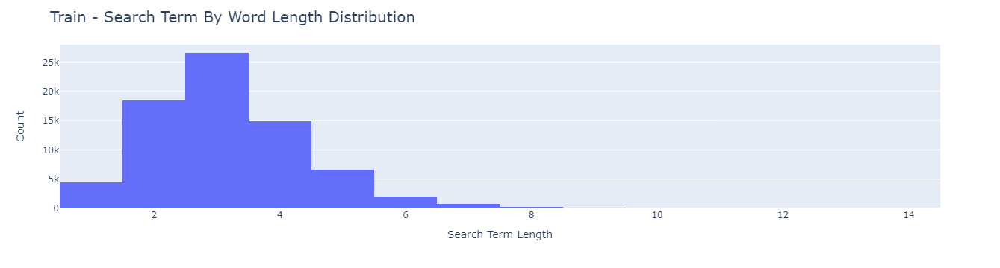

In [15]:
plot_word_length_distribution(train_df, 'Train', 'search_term', "Search Term")

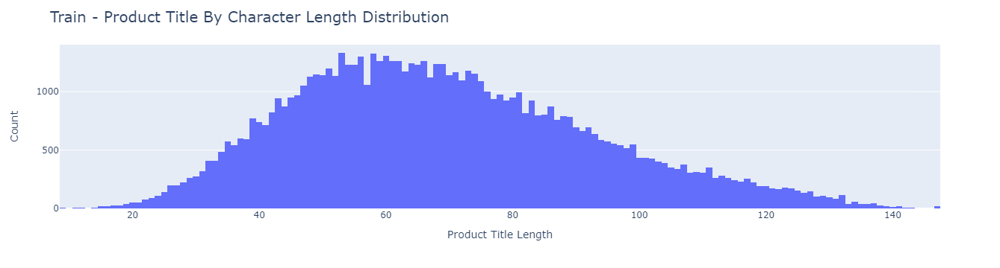

In [16]:
plot_characters_length_distribution(train_df, 'Train', 'product_title', "Product Title")

### Test Analysis

In [18]:
freq = calculate_product_frequency(test_df, 'product_uid')
print('Product UID frequency:')
print('Mean: {}'.format(freq['Mean']))
print('Min: {}'.format(freq['Min']))
print('Max: {}'.format(freq['Max']))

Product UID frequency:
Mean: 1.7103734865585882
Min: 1
Max: 52


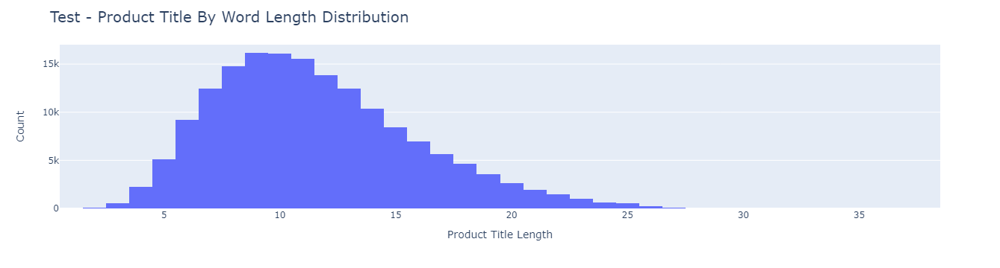

In [20]:
plot_word_length_distribution(test_df, 'Test', 'product_title', "Product Title")

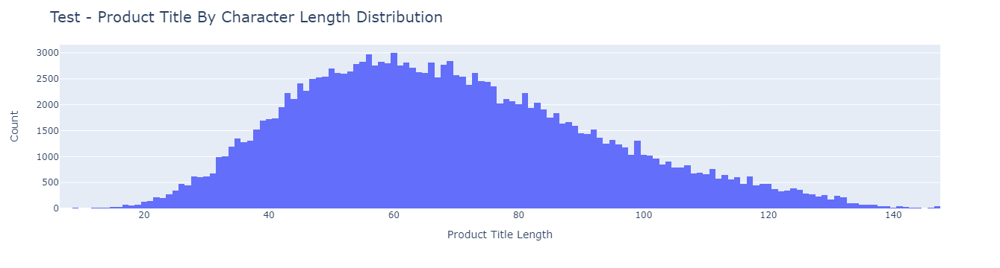

In [22]:
plot_characters_length_distribution(test_df, 'Test', 'product_title', "Product Title")

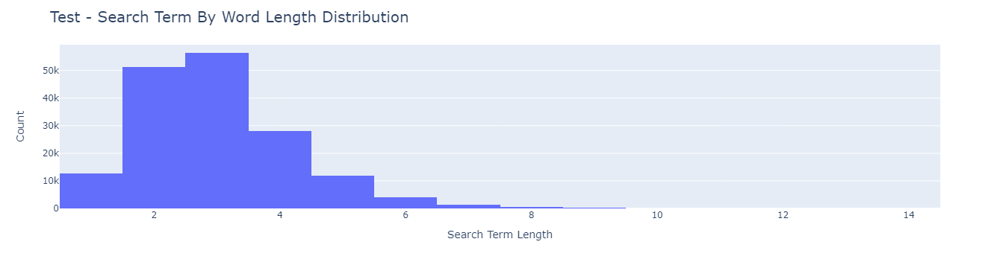

In [21]:
plot_word_length_distribution(test_df, 'Test', 'search_term', "Search Term")

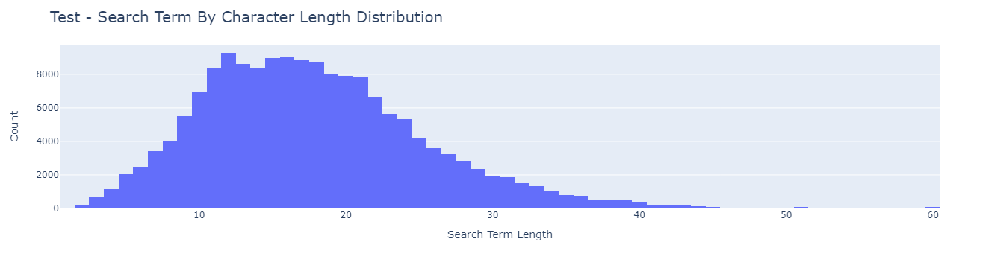

In [23]:
plot_characters_length_distribution(test_df, 'Test', 'search_term', "Search Term")

### product description analysis

In [31]:
product_descriptions_df = pd.read_csv(descriptions_path + ".zip", encoding="ISO-8859-1", compression='zip')
product_descriptions_df.head()

,product_uid,product_description
0,100001,"Not only do angles make joints stronger, they ..."
1,100002,BEHR Premium Textured DECKOVER is an innovativ...
2,100003,Classic architecture meets contemporary design...
3,100004,The Grape Solar 265-Watt Polycrystalline PV So...
4,100005,Update your bathroom with the Delta Vero Singl...


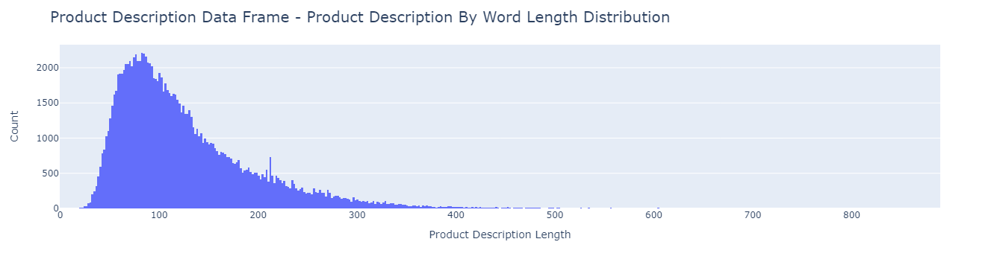

In [32]:
plot_word_length_distribution(product_descriptions_df, 'Product Description Data Frame', 'product_description', 'Product Description')

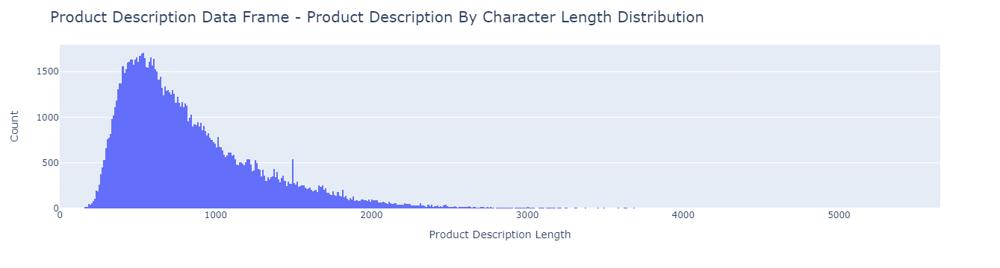

In [33]:
plot_characters_length_distribution(product_descriptions_df, 'Product Description Data Frame', 'product_description', 'Product Description')

# **Pre-Processing**

## General Pre-Processing

Remove all 'ignored' test samples

In [27]:
solution_df = pd.read_csv(test_labels_path, encoding="ISO-8859-1")

In [28]:
mod_test_df = pd.merge(test_df, solution_df, on='id')
mod_test_df = mod_test_df[mod_test_df['relevance'] != -1]
mod_test_df.drop(columns=['Usage'], axis=1, inplace=True)
mod_test_df.reset_index(drop=True, inplace=True)
mod_test_df

,id,product_uid,product_title,search_term,relevance
0,4,100001,Simpson Strong-Tie 12-Gauge Angle,metal l brackets,2.33
1,5,100001,Simpson Strong-Tie 12-Gauge Angle,simpson sku able,2.33
2,6,100001,Simpson Strong-Tie 12-Gauge Angle,simpson strong ties,2.67
3,7,100001,Simpson Strong-Tie 12-Gauge Angle,simpson strong tie hcc668,2.00
4,10,100003,STERLING Ensemble 33-1/4 in. x 60 in. x 75-1/4...,bath and shower kit,2.67
...,...,...,...,...,...
112062,221467,206644,MAX 0-Gauge Super Roofer,roof nailing gun,2.33
112063,221468,206645,GROHE Ladylux 3 Pro Single-Handle Pull-Down Du...,kitchen pro grout,1.00
112064,221469,206646,60 in. x 30 in. TileKit Bathtub Wall Set in Bo...,tilekit 30 x 60 wall bone,2.67
112065,221470,206647,Forum Novelties Girls Little Pink Princess Cos...,light switchvers for little girls,1.00


removing Upper case letters

In [29]:
mod_test_df['product_title'] = mod_test_df['product_title'].str.lower()
mod_test_df['search_term'] = mod_test_df['search_term'].str.lower()
train_df['product_title'] = mod_test_df['product_title'].str.lower()
train_df['search_term'] = mod_test_df['search_term'].str.lower()

removing conjunction-like words

In [ ]:
def remove_conjuction_words(df, column_name):
    res_df = df.copy()
    conjunction_set = set(['is', 'in' ,'and', 'for', 'or','yet','so','nor','both','whether','but','also','either','neither','just','the','as','then',
                       'than','such','that','after','although','much','by','inasmuch','even','when','where','since','because','whose','before','until','how','like', 'i',
                  'want', 'a', 'an'])
    # found = False
    count = 0
    for i in range(len(res_df.index)):
        for word in conjunction_set:
            df_word = res_df[column_name].iloc[i]
            if ( word  + ' ') in  df_word:
                count += 1
                # print(word)
                # print(f'before: {df_word}')
                res = ' '.join([w for w in df_word.split() if w not in conjunction_set])
                res_df[column_name].iloc[i] = res
                # print(f'after {res_df[column_name].iloc[i]}')
                # print(i)
        #         found = True
        #         break
        # if found:
        #     break
    print(f' changed {count} rows')
    return res_df

train_df = remove_conjuction_words(train_df,'search_term')
train_df = remove_conjuction_words(train_df,'product_title')
mod_test_df = remove_conjuction_words(mod_test_df,'product_title')
mod_test_df = remove_conjuction_words(mod_test_df,'search_term')


In [31]:
train_df.head()

,id,product_uid,product_title,search_term,relevance,product_title_length,search_term_length
0,2,100001,simpson strong-tie 12-gauge angle,metal l brackets,3.00,33,13
1,3,100001,simpson strong-tie 12-gauge angle,simpson sku able,2.50,33,9
2,9,100002,simpson strong-tie 12-gauge angle,simpson strong ties,3.00,79,9
3,16,100005,simpson strong-tie 12-gauge angle,simpson strong tie hcc668,2.33,78,16
4,17,100005,sterling ensemble 33-1/4 in. x 60 in. x 75-1/4...,bath shower kit,2.67,78,18


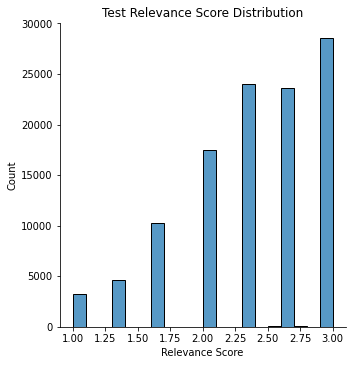

In [35]:
plot_relevance_score_distribution(test_df, 'Test')

Analyzing brands and material test and train distribution

In [32]:
atributes_df = pd.read_csv('content/attributes.csv', encoding="ISO-8859-1")
brands_df = atributes_df[atributes_df.name == "MFG Brand Name"]
brands_df['value'] = brands_df['value'].str.lower()
brands_set = set(brands_df.value)

materials_df = atributes_df[atributes_df.name == "Material"]
materials_df['value'] = materials_df['value'].str.lower()
materials_set = set(materials_df.value)

test_uids = set(mod_test_df.product_uid)
train_uids = set(train_df.product_uid) 
# cheking difference between test and train brands
test_only = set()
train_only = set()
both = set()
none = set()
for brand in brands_set:
    in_test = False
    in_train = False
    products_uids = brands_df[brands_df['value'] == brand].product_uid
    for uid in products_uids:
        uid = int(uid)
        if uid in train_uids:
            in_train = True
        if uid in test_uids:
            in_test = True
        if in_test and in_train:
            continue 
    if in_test and in_train:
        both.add(brand)
    elif in_test and not in_train:
        test_only.add(brand)
    elif not in_test and in_train:
        train_only.add(brand)
    else:
        none.add(brand)    
        
print('Brand Distrib')
print(f'difference: test:{len(test_only)}, train: {len(train_only)}')
print(f'in none:{len(none)}')
print(f'in both:{len(both)}')


# cheking difference between test and train materials
test_only = set()
train_only = set()
for material in materials_set:
    in_test = False
    in_train = False
    products_uids = materials_df[materials_df['value'] == material].product_uid
    for uid in products_uids:
        uid = int(uid)
        if uid in train_uids:
            in_train = True
        if uid in test_uids:
            in_test = True
        if in_test and in_train:
            continue 
    if in_test and in_train:
        both.add(material)
    elif in_test and not in_train:
        test_only.add(material)
    elif not in_test and in_train:
        train_only.add(material)
    else:
        none.add(material)
print()
print('Metrial Distrib')
print(f'difference: test:{len(test_only)}, train: {len(train_only)}')
print(f'in none:{len(none)}')
print(f'in both:{len(both)}')

/home/idoliv/.conda/envs/my_env/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/idoliv/.conda/envs/my_env/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Brand Distrib
difference: test:733, train: 365
in none:412
in both:2765

Metrial Distrib
difference: test:173, train: 106
in none:512
in both:3094


Write the modified dataframes to a .csv file

In [33]:
train_df.to_csv(mod_train_path, index=False)
mod_test_df.to_csv(mod_test_path, index=False)

In [34]:
train_df = pd.read_csv(mod_train_path, encoding="ISO-8859-1")
test_df = pd.read_csv(mod_test_path, encoding="ISO-8859-1")
corpus =  pd.concat([train_df, test_df], axis=0)

In [35]:
train_df.head()

,id,product_uid,product_title,search_term,relevance,product_title_length,search_term_length
0,2,100001,simpson strong-tie 12-gauge angle,metal l brackets,3.00,33,13
1,3,100001,simpson strong-tie 12-gauge angle,simpson sku able,2.50,33,9
2,9,100002,simpson strong-tie 12-gauge angle,simpson strong ties,3.00,79,9
3,16,100005,simpson strong-tie 12-gauge angle,simpson strong tie hcc668,2.33,78,16
4,17,100005,sterling ensemble 33-1/4 in. x 60 in. x 75-1/4...,bath shower kit,2.67,78,18


### Train Validation split
beucase out model has a big data, we decided to go with the train - test split validation technique 

In [36]:
split_index = math.floor(0.8 * len(train_df.index))
all_train_df = train_df.copy()
val_df = train_df.iloc[split_index:]
val_df.reset_index(drop=True, inplace=True)
train_df = train_df.iloc[:split_index]
train_df.reset_index(drop=True, inplace=True)


# Common Functions

In [37]:
def RMSE(y_actual, y_predicted):
    MSE = np.square(np.subtract(y_actual,y_predicted)).mean() 
    RMSE = math.sqrt(MSE)
    return RMSE

In [38]:
def MAE(y_actual, y_predicted):
    return mean_absolute_error(y_actual, y_predicted)

In [39]:
def to_tokens(text):
    text = text.replace(' ', ',')
    # text = text.replace('.', ',')
    text = text.replace('\n', ',')
    text = text.replace(';', ',')
    text = text.replace('_', ',')
    text = text.replace('+', ',')
    text = text.replace('-', ',')
    text = text.replace('\'', ',')
    return text.split(',')

In [40]:
def split_text(old_df):
    df = old_df.copy()
    df.search_term = [to_tokens(term) for term in df.search_term]
    df.product_title = [to_tokens(term) for term in df.product_title]
    return df

In [41]:
def gather_feature_extraction_samples(data_loader, model):
    preds_1 = []
    preds_2 = []
    labels = []
    last_print = 0
    for batch, (product_title, search_term, y) in enumerate(data_loader):
        product_title = product_title.to(device)
        search_term = search_term.to(device)
        y = y.to(dtype=torch.float)
        y = y.to(device)
        x1, x2 = model(product_title, search_term)
        labels.append(y.cpu().detach().numpy())
        preds_1.append(x1.cpu().detach().numpy())
        preds_2.append(x2.cpu().detach().numpy())
        if last_print + 0.2 < batch/len(data_loader):
            last_print += 0.2
            print(f'finished {int(100*(batch/len(data_loader)))}%')
    
    preds_1 = np.array(preds_1).squeeze()
    preds_2 = np.array(preds_2).squeeze()
    features = np.concatenate([preds_1, preds_2], axis=1).squeeze()
    print(f'finished extracting')
    return features, labels

# LSTM Construction

In [42]:
class SiameseNetworkLSTM(nn.Module):
    def __init__(self, embedding_dim, lstm_hidden_dim,dropout, num_layers=1 ):
        super().__init__()
        self.lstm = nn.LSTM(embedding_dim, lstm_hidden_dim,num_layers = num_layers,dropout=dropout, batch_first=True)

    def forward(self,x1,x2):
        output_x1, (hidden_x1, cn_x1) = self.lstm(x1)
        output_x2, (hidden_x2, cn_x2) = self.lstm(x2)
        return hidden_x1,hidden_x2

In [43]:
def normalize_relevance(relevance):
    return (relevance -1 )/2

In [44]:
def train_loop(data_loader, model, device, loss_fn, distance_func):
    model.train()
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
    size = len(data_loader.dataset)
    num_batches = len(data_loader)
    train_loss=0
    counter = 0
    last_print = 0
    for batch, (product_title,search_term,y) in enumerate(data_loader):
        product_title = product_title.to(device)
        search_term = search_term.to(device)
        y = y.to(dtype=torch.float)
        y = y.to(device)
        x1,x2 = model(product_title, search_term)
        pred = distance_func(x1[0],x2[0])
        # pred = (pred *2 )+1
        loss = loss_fn(pred, normalize_relevance(y))
        if type(loss_fn) == type(nn.MSELoss()):
            loss = torch.sqrt(loss)
        train_loss += loss
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        if last_print + 0.4 < batch/num_batches:
            last_print += 0.4
            print(f'finished {int(100*(batch/len(data_loader)))}%')
    loss = loss.item()
    train_loss /= num_batches
    print(f'train loss = {train_loss:8f}')
    return train_loss

def test_loop(data_loader, model, device, loss_fn, distance_func, test_text='validation'):
    model.eval()
    cos = nn.CosineSimilarity(dim=1)
    size=len(data_loader.dataset)
    num_batches = len(data_loader)
    test_loss=0
    last_print = 0
    with torch.no_grad():
        for batch, (product_title,search_term,y) in enumerate(data_loader):
            product_title = product_title.to(device)
            search_term = search_term.to(device)
            y = y.to(dtype=torch.float)
            y = y.to(device)
            x1,x2 = model(product_title, search_term)
            pred = distance_func(x1[0],x2[0])
            # pred = (pred *2 )+1
            loss = loss_fn(pred,  normalize_relevance(y))
            if type(loss_fn) == type(nn.MSELoss()):
                loss = torch.sqrt(loss)
            test_loss += loss
            if last_print + 0.4 < batch/num_batches:
                last_print += 0.4
                print(f'finished {int(100*(batch/len(data_loader)))}%')
 
    test_loss /= num_batches
    print(f'{test_text} loss = {test_loss:8f}')
    return test_loss

# Character Level Task

## Naive Solution

### Count Vectorizer

corpus construction

In [45]:
corpus_search = list(train_df['search_term'])
corpus_title = list(train_df['product_title'])
labels =  list(train_df['relevance'])

In [46]:
%%time
title_vectorizer = CountVectorizer(analyzer = 'char')
X_title = title_vectorizer.fit_transform(corpus_title)

search_vectorizer = CountVectorizer(analyzer = 'char',vocabulary= title_vectorizer.get_feature_names_out() )
X_search = search_vectorizer.fit_transform(corpus_search)

preds = list()

for i in range(len(train_df.index)):
    similarity = cosine_similarity(X_search[i], X_title[i])
    similarity = (similarity * 2) +1
    preds.append(similarity[0][0])


CPU times: user 48.5 s, sys: 50.7 ms, total: 48.5 s
Wall time: 48.5 s


In [47]:
df_cosine = pd.DataFrame({'pred': preds, 'label': labels})
df_cosine


,pred,label
0,2.191499,3.00
1,2.423877,2.50
2,2.616525,3.00
3,2.478687,2.33
4,2.570552,2.67
...,...,...
59248,2.286515,2.33
59249,2.597965,2.33
59250,1.871454,3.00
59251,2.490930,2.00


now we would like check whether the naive solution is better than ranodmize.
we will take the average score and comapre the MSE of average score with the MSE of the naive solution

In [48]:

average_relevance = sum(train_df.relevance) / len(train_df.index)
naive_dist = 0
rand_dist = 0
for idx,label in enumerate(df_cosine.label):
    pred = (df_cosine.pred[idx] /2 ) -1
    naive_dist += abs(df_cosine.pred[idx] - label)
    rand_dist += abs(average_relevance - label)
# print(f'naive distance average {naive_dist/  len(train_df.index)}')


naive distance average 0.4750244491608411


In [49]:
print(f'naive RMSE: {RMSE(list(df_cosine.label),list(df_cosine.pred))}')
average = [average_relevance] * len(train_df.index)


naive RMSE: 0.5921473911533216


In [50]:
print(f'naive MAE: {MAE(list(df_cosine.label),list(df_cosine.pred))}')


naive MAE: 0.47502444916084713


## Character Level LSTM Solution

### configurations

In [335]:
batch_size = 32
learning_rate = 1e-3
window_size = 50
embedding_dim = 3 
lstm_hidden_dim = 20 
dropout = 0
num_layers = 1

### Embedding

In [336]:
%%time
vector_size =3
corpus_splited = split_text(corpus) 
data_all = list(corpus_splited.product_title) + list(corpus_splited.search_term)
data = [list(sentence) for sentence in data_all]
average_word_size = 0
word_count = 0
for sentence in train_df.product_title:
    words = sentence.split()
    for word in words:
        average_word_size += len(word)
        word_count += 1
average_word_size /= word_count
# data
char_embedding = gensim.models.Word2Vec(data, min_count = 1, vector_size =embedding_dim, window = math.floor(average_word_size),sg=1)


CPU times: user 38.1 s, sys: 63.9 ms, total: 38.2 s
Wall time: 14.9 s


In [338]:
print(f'max chars length: {max_len}')

max chars length: 127


In [339]:
char_embedding.wv.similarity('a','b')

0.7335358

### Dataset

In [239]:
def embed_sentence(sentence, embedding_model):
    chars = list(sentence)
    return [embedding_model.wv[char] for char in chars]

def pad_sentence(sentence, expected_len):
    if len(sentence) >  expected_len:
        return sentence[:expected_len]
    else:
        pad_len = expected_len -  len(sentence)
        return sentence + [0]*pad_len
        

In [240]:
class char_dataset(Dataset):
    def __init__(self, data, embedding_model, window_size):
        self.data = data
        self.embedding_model = embedding_model
        self.window_size = window_size
        
    def __len__(self):
        return len(self.data.index)
    
    def __getitem__(self,idx):
        label = self.data.relevance[idx]
        product_title =  list(self.data.product_title[idx])
        product_title = pad_sentence(product_title,self.window_size)
        product_title_embedded = embed_sentence(product_title, self.embedding_model)
        search_term =  list(self.data.search_term[idx])
        search_term = pad_sentence(search_term,self.window_size)
        search_term_embedded = embed_sentence(search_term, self.embedding_model)
        
        return torch.FloatTensor(product_title_embedded) ,torch.FloatTensor(search_term_embedded), label
char_ds_train = char_dataset(split_text(train_df),char_embedding, window_size)
char_ds_val = char_dataset(split_text(val_df),char_embedding, window_size)
char_ds_test = char_dataset(split_text(test_df),char_embedding, window_size)

In [241]:
train_loader = DataLoader(char_ds_train, batch_size=batch_size, shuffle = False)
val_loader = DataLoader(char_ds_val, batch_size=batch_size, shuffle = False)

## RMSE
for RMSE we used torch mse with torch.sqrt (inside the train loop itself)

### Training

In [242]:
loss_fn = nn.MSELoss()
char_model = SiameseNetworkLSTM(embedding_dim, lstm_hidden_dim, num_layers = num_layers , dropout = dropout )

In [243]:
%%time
epochs = 10
char_history = []
char_model.to(device)
for epoch in range(epochs):
    print("epoch: ", epoch+1, "/", epochs)
    train_loss = train_loop(train_loader, char_model, device, loss_fn, nn.CosineSimilarity(dim=1))
    val_loss = test_loop(val_loader, char_model, device, loss_fn,  nn.CosineSimilarity(dim=1))
    char_history.append({'train_loss':train_loss.detach().cpu().numpy(), 'val_loss':val_loss.detach().cpu().numpy()})


epoch:  1 / 10
finished 40%
finished 80%
train loss = 0.389471
finished 40%
finished 80%
validation loss = 0.461490
epoch:  2 / 10
finished 40%
finished 80%
train loss = 0.323547
finished 40%
finished 80%
validation loss = 0.300803
epoch:  3 / 10
finished 40%
finished 80%
train loss = 0.282955
finished 40%
finished 80%
validation loss = 0.283042
epoch:  4 / 10
finished 40%
finished 80%
train loss = 0.275988
finished 40%
finished 80%
validation loss = 0.274604
epoch:  5 / 10
finished 40%
finished 80%
train loss = 0.270074
finished 40%
finished 80%
validation loss = 0.267032
epoch:  6 / 10
finished 40%
finished 80%
train loss = 0.267344
finished 40%
finished 80%
validation loss = 0.266217
epoch:  7 / 10
finished 40%
finished 80%
train loss = 0.267172
finished 40%
finished 80%
validation loss = 0.267049
epoch:  8 / 10
finished 40%
finished 80%
train loss = 0.266806
finished 40%
finished 80%
validation loss = 0.265845
epoch:  9 / 10
finished 40%
finished 80%
train loss = 0.266475
finished 

In [244]:
char_history

[{'train_loss': array(0.3894706, dtype=float32),
  'val_loss': array(0.46149033, dtype=float32)},
 {'train_loss': array(0.32354674, dtype=float32),
  'val_loss': array(0.30080333, dtype=float32)},
 {'train_loss': array(0.2829547, dtype=float32),
  'val_loss': array(0.28304216, dtype=float32)},
 {'train_loss': array(0.2759877, dtype=float32),
  'val_loss': array(0.27460375, dtype=float32)},
 {'train_loss': array(0.2700736, dtype=float32),
  'val_loss': array(0.26703188, dtype=float32)},
 {'train_loss': array(0.26734442, dtype=float32),
  'val_loss': array(0.26621684, dtype=float32)},
 {'train_loss': array(0.2671719, dtype=float32),
  'val_loss': array(0.26704893, dtype=float32)},
 {'train_loss': array(0.26680568, dtype=float32),
  'val_loss': array(0.26584542, dtype=float32)},
 {'train_loss': array(0.26647538, dtype=float32),
  'val_loss': array(0.26797417, dtype=float32)},
 {'train_loss': array(0.2668677, dtype=float32),
  'val_loss': array(0.26737928, dtype=float32)}]

In [245]:
train_losses = [item['train_loss'] for item in char_history]
val_losses = [item['val_loss'] for item in char_history]
d = {"train_loss" : train_losses, "val_loss":val_losses}
plot_df = pd.DataFrame(data = d)
plot_df

,train_loss,val_loss
0,0.3894706,0.46149033
1,0.32354674,0.30080333
2,0.2829547,0.28304216
3,0.2759877,0.27460375
4,0.2700736,0.26703188
5,0.26734442,0.26621684
6,0.2671719,0.26704893
7,0.26680568,0.26584542
8,0.26647538,0.26797417
9,0.2668677,0.26737928


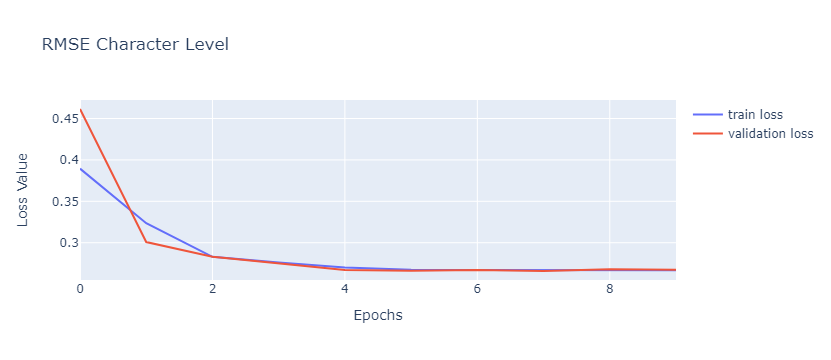

In [246]:

plot_loss([i for i in range(epochs)],plot_df, "RMSE Character Level")

### Test

In [247]:
char_ds_train = char_dataset(split_text(all_train_df),char_embedding, window_size)
test_char_ds = char_dataset(split_text(test_df),char_embedding, window_size)

train_loader = DataLoader(char_ds_train, batch_size=batch_size, shuffle = False)
test_loader = DataLoader(test_char_ds, batch_size=batch_size, shuffle = False)

In [248]:
char_model = SiameseNetworkLSTM(embedding_dim, lstm_hidden_dim, num_layers = num_layers , dropout = dropout )

In [249]:
%%time
epochs = 8
char_history = []
char_model.to(device)
for epoch in range(epochs):
    print("epoch: ", epoch+1, "/", epochs)
    train_loss = train_loop(train_loader, char_model, device, loss_fn, nn.CosineSimilarity(dim=1))


epoch:  1 / 8
finished 40%
finished 80%
train loss = 0.403725
epoch:  2 / 8
finished 40%
finished 80%
train loss = 0.315202
epoch:  3 / 8
finished 40%
finished 80%
train loss = 0.273885
epoch:  4 / 8
finished 40%
finished 80%
train loss = 0.270288
epoch:  5 / 8
finished 40%
finished 80%
train loss = 0.268247
epoch:  6 / 8
finished 40%
finished 80%
train loss = 0.266779
epoch:  7 / 8
finished 40%
finished 80%
train loss = 0.265701
epoch:  8 / 8
finished 40%
finished 80%
train loss = 0.265280
CPU times: user 3min 44s, sys: 589 ms, total: 3min 45s
Wall time: 3min 45s


In [250]:
%%time 
test_loss = test_loop(test_loader, char_model, device, loss_fn,  nn.CosineSimilarity(dim=1))


finished 40%
finished 80%
validation loss = 0.279276
CPU times: user 33.2 s, sys: 26.7 ms, total: 33.2 s
Wall time: 33.2 s


## MAE 

### Training

In [340]:
char_ds_train = char_dataset(split_text(train_df),char_embedding, window_size)
char_ds_val = char_dataset(split_text(val_df),char_embedding, window_size)
char_ds_test = char_dataset(split_text(test_df),char_embedding, window_size)

In [341]:
train_loader = DataLoader(char_ds_train, batch_size=batch_size, shuffle = False)
val_loader = DataLoader(char_ds_val, batch_size=batch_size, shuffle = False)

In [342]:
loss_fn = nn.L1Loss()
char_model = SiameseNetworkLSTM(embedding_dim, lstm_hidden_dim, num_layers = num_layers , dropout = dropout )

In [343]:
%%time
epochs = 10
char_history = []
char_model.to(device)
for epoch in range(epochs):
    print("epoch: ", epoch+1, "/", epochs)
    train_loss = train_loop(train_loader, char_model, device, loss_fn, nn.CosineSimilarity(dim=1))
    val_loss = test_loop(val_loader, char_model, device, loss_fn,  nn.CosineSimilarity(dim=1))
    char_history.append({'train_loss':train_loss.detach().cpu().numpy(), 'val_loss':val_loss.detach().cpu().numpy()})


epoch:  1 / 10
finished 40%
finished 80%
train loss = 0.373941
finished 40%
finished 80%
validation loss = 0.461494
epoch:  2 / 10
finished 40%
finished 80%
train loss = 0.387875
finished 40%
finished 80%
validation loss = 0.461478
epoch:  3 / 10
finished 40%
finished 80%
train loss = 0.327150
finished 40%
finished 80%
validation loss = 0.323186
epoch:  4 / 10
finished 40%
finished 80%
train loss = 0.292096
finished 40%
finished 80%
validation loss = 0.460509
epoch:  5 / 10
finished 40%
finished 80%
train loss = 0.389313
finished 40%
finished 80%
validation loss = 0.461494
epoch:  6 / 10
finished 40%
finished 80%
train loss = 0.312647
finished 40%
finished 80%
validation loss = 0.290743
epoch:  7 / 10
finished 40%
finished 80%
train loss = 0.275292
finished 40%
finished 80%
validation loss = 0.271669
epoch:  8 / 10
finished 40%
finished 80%
train loss = 0.269167
finished 40%
finished 80%
validation loss = 0.265507
epoch:  9 / 10
finished 40%
finished 80%
train loss = 0.267074
finished 

In [344]:
train_losses = [item['train_loss'] for item in char_history]
val_losses = [item['val_loss'] for item in char_history]
d = {"train_loss" : train_losses, "val_loss":val_losses}
plot_df = pd.DataFrame(data = d)
plot_df

,train_loss,val_loss
0,0.37394062,0.4614938
1,0.38787547,0.4614779
2,0.32715014,0.32318562
3,0.29209635,0.4605088
4,0.38931298,0.46149373
5,0.31264716,0.2907432
6,0.27529162,0.27166903
7,0.2691666,0.26550692
8,0.2670742,0.26597688
9,0.26622948,0.26590058


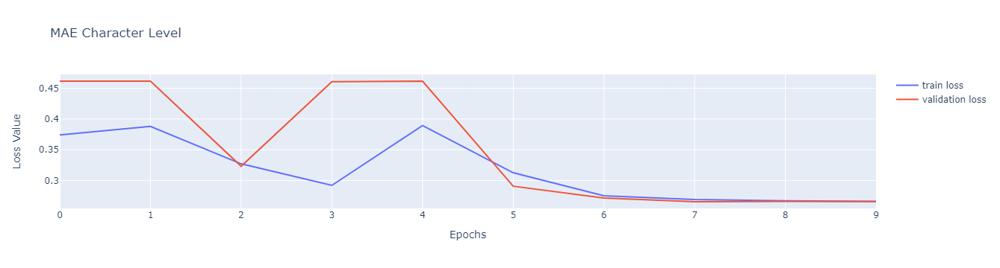

In [345]:
plot_loss([i for i in range(epochs)],plot_df, "MAE Character Level")

### Test

In [346]:
char_ds_train = char_dataset(split_text(all_train_df),char_embedding, window_size)
test_char_ds = char_dataset(split_text(test_df),char_embedding, window_size)

train_loader = DataLoader(char_ds_train, batch_size=batch_size, shuffle = False)
test_loader = DataLoader(test_char_ds, batch_size=batch_size, shuffle = False)

In [347]:
char_model = SiameseNetworkLSTM(embedding_dim, lstm_hidden_dim, num_layers = num_layers , dropout = dropout )

In [348]:
%%time
epochs = 10
char_history = []
char_model.to(device)
for epoch in range(epochs):
    print("epoch: ", epoch+1, "/", epochs)
    train_loss = train_loop(train_loader, char_model, device, loss_fn, nn.CosineSimilarity(dim=1))


epoch:  1 / 10
finished 40%
finished 80%
train loss = 0.364603
epoch:  2 / 10
finished 40%
finished 80%
train loss = 0.275673
epoch:  3 / 10
finished 40%
finished 80%
train loss = 0.267366
epoch:  4 / 10
finished 40%
finished 80%
train loss = 0.265806
epoch:  5 / 10
finished 40%
finished 80%
train loss = 0.264917
epoch:  6 / 10
finished 40%
finished 80%
train loss = 0.264421
epoch:  7 / 10
finished 40%
finished 80%
train loss = 0.264248
epoch:  8 / 10
finished 40%
finished 80%
train loss = 0.264388
epoch:  9 / 10
finished 40%
finished 80%
train loss = 0.264145
epoch:  10 / 10
finished 40%
finished 80%
train loss = 0.264113
CPU times: user 4min 31s, sys: 791 ms, total: 4min 32s
Wall time: 4min 32s


In [ ]:
%%time 
test_loss = test_loop(test_loader, char_model, device, loss_fn,  nn.CosineSimilarity(dim=1))


finished 40%
finished 80%
validation loss = 0.276287
CPU times: user 33.6 s, sys: 45.8 ms, total: 33.7 s
Wall time: 33.7 s


## Using classic ML model

In [ ]:
char_ds_train = char_dataset(split_text(all_train_df),char_embedding, window_size)
test_char_ds = char_dataset(split_text(test_df),char_embedding, window_size)

In [ ]:
ml_char_train_loader = DataLoader(char_ds_train, batch_size=1, shuffle = False)
ml_char_test_loader = DataLoader(test_char_ds, batch_size = 1, shuffle = False)

In [352]:
X_char_train, y_char_train = gather_feature_extraction_samples(ml_char_train_loader, char_model)
X_char_test, y_char_test =  gather_feature_extraction_samples(ml_char_test_loader, char_model)

finished 20%
finished 40%
finished 60%
finished 80%
finished extracting
finished 20%
finished 40%
finished 60%
finished 80%
finished extracting


In [353]:
%%time
print("XGBoost character level fit time:")
xgb_regressor = xgb.XGBRegressor()
xgb_regressor.fit(X_char_train, y_char_train)


XGBoost character level fit time:
CPU times: user 58.4 s, sys: 63.6 ms, total: 58.4 s
Wall time: 9.87 s


XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, ...)

In [354]:
%%time
print("XGBoost character level predict time:")
xgb_pred = xgb_regressor.predict(X_char_test)

XGBoost character level predict time:
CPU times: user 392 ms, sys: 2.01 ms, total: 394 ms
Wall time: 68.7 ms


In [355]:
xgb_rmse = math.sqrt(mean_squared_error(y_char_test, xgb_pred))
xgb_mae = mean_absolute_error(y_char_test, xgb_pred)

print(f"Root Mean Squared Error: {xgb_rmse}")
print(f"Mean Absolute Error: {xgb_mae}")

Root Mean Squared Error: 0.5430872122434022
Mean Absolute Error: 0.44537633657455444


In [356]:
%%time
print("LightGBM character level fit time:")
lgb_regressor = lgb.LGBMRegressor()
lgb_regressor.fit(X_char_train, y_char_train)


LightGBM character level fit time:


/home/idoliv/.conda/envs/my_env/lib/python3.7/site-packages/sklearn/utils/validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



CPU times: user 2.86 s, sys: 29 ms, total: 2.89 s
Wall time: 595 ms


LGBMRegressor()

In [357]:
%%time
print("LightGBM character level predict time:")
lgb_pred = lgb_regressor.predict(X_char_test)

LightGBM character level predict time:
CPU times: user 444 ms, sys: 995 µs, total: 445 ms
Wall time: 78.1 ms


In [358]:
lgb_rmse = math.sqrt(mean_squared_error(y_char_test, lgb_pred))
lgb_mae = mean_absolute_error(y_char_test, lgb_pred)

print(f"Root Mean Squared Error: {lgb_rmse}")
print(f"Mean Absolute Error: {lgb_mae}")

Root Mean Squared Error: 0.5371770368216288
Mean Absolute Error: 0.44040891182318387


# Word Level LSTM

## configurations

In [ ]:
embedding_dim = 5
batch_size = 32
learning_rate = 1e-3
window_size = 90
lstm_hidden_dim = 15 
dropout = 0
num_layers = 1

## pre process data

In [ ]:
word_train_df = split_text(train_df)
word_train_df.head()

,id,product_uid,product_title,search_term,relevance,product_title_length,search_term_length
0,2,100001,"[simpson, strong, tie, 12, gauge, angle]","[metal, l, brackets]",3.00,33,13
1,3,100001,"[simpson, strong, tie, 12, gauge, angle]","[simpson, sku, able]",2.50,33,9
2,9,100002,"[simpson, strong, tie, 12, gauge, angle]","[simpson, strong, , ties]",3.00,79,9
3,16,100005,"[simpson, strong, tie, 12, gauge, angle]","[simpson, strong, tie, hcc668]",2.33,78,16
4,17,100005,"[sterling, ensemble, 33, 1/4, in., x, 60, in.,...","[bath, shower, kit]",2.67,78,18


In [ ]:
word_val_df = split_text(val_df)
word_val_df.head()

,id,product_uid,product_title,search_term,relevance,product_title_length,search_term_length
0,178998,173850,"[black, decker, 0.065, in., x, 40, ft., dual, ...","[black, decke, weed, eaters]",2.67,71,15
1,179002,173854,"[black, decker, 0.065, in., x, 40, ft., dual, ...","[blakck, decker, edger]",2.33,65,19
2,179005,173855,"[black, decker, 0.065, in., x, 40, ft., dual, ...","[one, , , 0.065, spool]",2.33,67,25
3,179007,173856,"[black, decker, 0.065, in., x, 40, ft., dual, ...","[remington, weed, trimmer, spools]",1.33,46,23
4,179008,173856,"[black, decker, 0.065, in., x, 40, ft., dual, ...","[ryobi, dual, line, replacement]",1.33,46,17


after splitting the words, we will create embedding for the corpus

## Embedding

In [ ]:
vector_size =3
corpus_splited = split_text(corpus) 
data_all = list(corpus_splited.product_title) + list(corpus_splited.search_term)
max_length = max([len(s) for s in data_all])
window_size = max_length
# data
word_embedding = Word2Vec(sentences=data_all, vector_size=embedding_dim, window=5, min_count=1)
word_embedding.train(data_all, total_examples=len(data_all), epochs =20)


(49227278, 56612440)

In [ ]:
print(f'max sentence lentgh is {max_length}')

max sentence lentgh is 37


In [ ]:
word_embedding.wv['strong']

array([ -4.740241 ,   6.5030384, -11.877178 ,   1.6152806,  -3.30088  ],
      dtype=float32)

## Dataset

In [187]:
def embed_word(sentence, embedding_model):
    return [embedding_model.wv[word] for word in sentence]

def pad_sentence(sentence, expected_len):
    if len(sentence) >  expected_len:
        return sentence[:expected_len]
    else:
        pad_len = expected_len -  len(sentence)
        return sentence + [0]*pad_len
        

In [188]:
class Word_dataset(Dataset):
    def __init__(self, data, embedding_model, window_size):
        self.data = data
        self.embedding_model = embedding_model
        self.window_size = window_size
        
    def __len__(self):
        return len(self.data.index)
    
    def __getitem__(self,idx):
        label = self.data.relevance[idx]
        product_title =  self.data.product_title[idx]
        product_title = pad_sentence(product_title,max_length)
        product_title_embedded = embed_word(product_title, self.embedding_model)
        search_term =  self.data.search_term[idx]
        search_term = pad_sentence(search_term,max_length)
        search_term_embedded = embed_word(search_term, self.embedding_model)
        
        return torch.FloatTensor(product_title_embedded) ,torch.FloatTensor(search_term_embedded), label
word_ds = Word_dataset(word_train_df,word_embedding, window_size)
word_ds_val =  Word_dataset(word_val_df,word_embedding, window_size)

In [189]:
train_loader = DataLoader(word_ds, batch_size=batch_size, shuffle = False)
val_loader = DataLoader(word_ds_val, batch_size=batch_size, shuffle = False)

 ## RMSE

### Training

In [190]:
loss_fn = nn.MSELoss()
word_model = SiameseNetworkLSTM(embedding_dim, lstm_hidden_dim, num_layers = num_layers , dropout = dropout)


In [191]:
%%time
epochs = 7
word_history = []
word_model.to(device)
for epoch in range(epochs):
    print("epoch: ", epoch+1, "/", epochs)
    train_loss = train_loop(train_loader, word_model, device, loss_fn ,nn.CosineSimilarity(dim=1))
    val_loss = test_loop(val_loader, word_model, device, loss_fn,  nn.CosineSimilarity(dim=1))
    word_history.append({'train_loss':train_loss.detach().cpu().numpy(), 'val_loss':val_loss.detach().cpu().numpy()})


epoch:  1 / 7
finished 40%
finished 80%
train loss = 0.298558
finished 40%
finished 80%
validation loss = 0.272779
epoch:  2 / 7
finished 40%
finished 80%
train loss = 0.271611
finished 40%
finished 80%
validation loss = 0.274137
epoch:  3 / 7
finished 40%
finished 80%
train loss = 0.269059
finished 40%
finished 80%
validation loss = 0.268505
epoch:  4 / 7
finished 40%
finished 80%
train loss = 0.267757
finished 40%
finished 80%
validation loss = 0.265192
epoch:  5 / 7
finished 40%
finished 80%
train loss = 0.266869
finished 40%
finished 80%
validation loss = 0.265060
epoch:  6 / 7
finished 40%
finished 80%
train loss = 0.266393
finished 40%
finished 80%
validation loss = 0.264817
epoch:  7 / 7
finished 40%
finished 80%
train loss = 0.265961
finished 40%
finished 80%
validation loss = 0.266546
CPU times: user 2min 33s, sys: 488 ms, total: 2min 34s
Wall time: 2min 33s


In [192]:

train_losses = [item['train_loss'] for item in word_history]
val_losses = [item['val_loss'] for item in word_history]
d = {"train_loss" : train_losses, "val_loss":val_losses}
plot_df = pd.DataFrame(data = d)
plot_df

,train_loss,val_loss
0,0.2985583,0.27277932
1,0.27161077,0.27413702
2,0.26905888,0.26850545
3,0.26775676,0.2651921
4,0.26686928,0.26506007
5,0.26639268,0.26481706
6,0.26596126,0.2665456


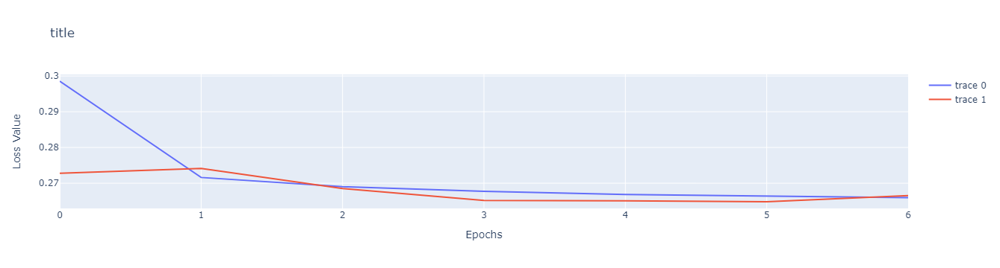

In [193]:
plot_loss([i for i in range(epochs)],plot_df, "RMSE Word Level")

### Test

In [194]:
word_ds_train = Word_dataset(split_text(all_train_df),word_embedding, window_size)
test_word_ds = Word_dataset(split_text(test_df),word_embedding, window_size)

train_loader = DataLoader(word_ds_train, batch_size=batch_size, shuffle = False)
test_loader = DataLoader(test_word_ds, batch_size=batch_size, shuffle = False)

In [195]:
word_model = SiameseNetworkLSTM(embedding_dim, lstm_hidden_dim, num_layers = num_layers , dropout = dropout )

In [196]:
%%time
epochs = 8
char_history = []
word_model.to(device)
for epoch in range(epochs):
    print("epoch: ", epoch+1, "/", epochs)
    train_loss = train_loop(train_loader, word_model, device, loss_fn, nn.CosineSimilarity(dim=1))


epoch:  1 / 8
finished 40%
finished 80%
train loss = 0.355315
epoch:  2 / 8
finished 40%
finished 80%
train loss = 0.270406
epoch:  3 / 8
finished 40%
finished 80%
train loss = 0.267324
epoch:  4 / 8
finished 40%
finished 80%
train loss = 0.266064
epoch:  5 / 8
finished 40%
finished 80%
train loss = 0.265828
epoch:  6 / 8
finished 40%
finished 80%
train loss = 0.265286
epoch:  7 / 8
finished 40%
finished 80%
train loss = 0.264331
epoch:  8 / 8
finished 40%
finished 80%
train loss = 0.264446
CPU times: user 3min, sys: 584 ms, total: 3min
Wall time: 3min


In [197]:
%%time 
test_loss = test_loop(test_loader, word_model, device, loss_fn,  nn.CosineSimilarity(dim=1))


finished 40%
finished 80%
validation loss = 0.279567
CPU times: user 27.6 s, sys: 19.7 ms, total: 27.6 s
Wall time: 27.6 s


## MAE

### Training

In [198]:
loss_fn = nn.L1Loss()
word_model = SiameseNetworkLSTM(embedding_dim, lstm_hidden_dim, num_layers = num_layers , dropout = dropout)


In [199]:
%%time
epochs = 7
word_history = []
word_model.to(device)
for epoch in range(epochs):
    print("epoch: ", epoch+1, "/", epochs)
    train_loss = train_loop(train_loader, word_model, device, loss_fn ,nn.CosineSimilarity(dim=1))
    val_loss = test_loop(val_loader, word_model, device, loss_fn,  nn.CosineSimilarity(dim=1))
    word_history.append({'train_loss':train_loss.detach().cpu().numpy(), 'val_loss':val_loss.detach().cpu().numpy()})


epoch:  1 / 7
finished 40%
finished 80%
train loss = 0.238498
finished 40%
finished 80%
validation loss = 0.220140
epoch:  2 / 7
finished 40%
finished 80%
train loss = 0.220567
finished 40%
finished 80%
validation loss = 0.212950
epoch:  3 / 7
finished 40%
finished 80%
train loss = 0.218954
finished 40%
finished 80%
validation loss = 0.211910
epoch:  4 / 7
finished 40%
finished 80%
train loss = 0.218442
finished 40%
finished 80%
validation loss = 0.211856
epoch:  5 / 7
finished 40%
finished 80%
train loss = 0.217947
finished 40%
finished 80%
validation loss = 0.209723
epoch:  6 / 7
finished 40%
finished 80%
train loss = 0.217351
finished 40%
finished 80%
validation loss = 0.209085
epoch:  7 / 7
finished 40%
finished 80%
train loss = 0.217677
finished 40%
finished 80%
validation loss = 0.211292
CPU times: user 3min 5s, sys: 544 ms, total: 3min 6s
Wall time: 3min 6s


In [200]:

train_losses = [item['train_loss'] for item in word_history]
val_losses = [item['val_loss'] for item in word_history]
d = {"train_loss" : train_losses, "val_loss":val_losses}
plot_df = pd.DataFrame(data = d)
plot_df

,train_loss,val_loss
0,0.23849772,0.22013971
1,0.22056726,0.21295018
2,0.21895404,0.21191007
3,0.21844189,0.21185637
4,0.217947,0.20972332
5,0.21735103,0.20908546
6,0.21767707,0.2112921


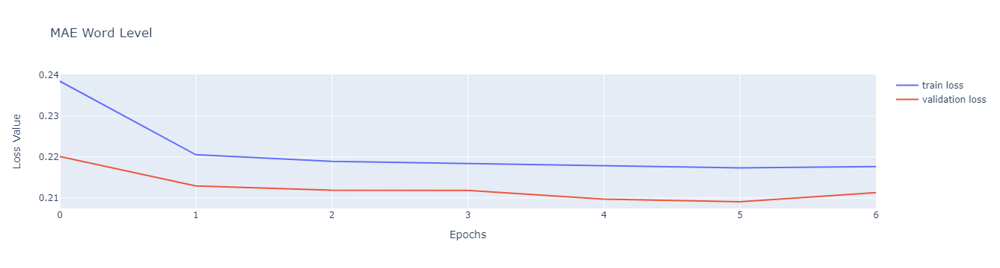

In [208]:
plot_loss([i for i in range(epochs)],plot_df, "MAE Word Level")

### Test

In [202]:
word_ds_train = Word_dataset(split_text(all_train_df),word_embedding, window_size)
test_word_ds = Word_dataset(split_text(test_df),word_embedding, window_size)

train_loader = DataLoader(word_ds_train, batch_size=batch_size, shuffle = False)
test_loader = DataLoader(test_word_ds, batch_size=batch_size, shuffle = False)

In [203]:
word_model = SiameseNetworkLSTM(embedding_dim, lstm_hidden_dim, num_layers = num_layers , dropout = dropout )

In [204]:
%%time
epochs = 8
char_history = []
word_model.to(device)
for epoch in range(epochs):
    print("epoch: ", epoch+1, "/", epochs)
    train_loss = train_loop(train_loader, word_model, device, loss_fn, nn.CosineSimilarity(dim=1))


epoch:  1 / 8
finished 40%
finished 80%
train loss = 0.242219
epoch:  2 / 8
finished 40%
finished 80%
train loss = 0.254456
epoch:  3 / 8
finished 40%
finished 80%
train loss = 0.251377
epoch:  4 / 8
finished 40%
finished 80%
train loss = 0.228102
epoch:  5 / 8
finished 40%
finished 80%
train loss = 0.229749
epoch:  6 / 8
finished 40%
finished 80%
train loss = 0.229511
epoch:  7 / 8
finished 40%
finished 80%
train loss = 0.230481
epoch:  8 / 8
finished 40%
finished 80%
train loss = 0.266103
CPU times: user 2min 59s, sys: 515 ms, total: 3min
Wall time: 3min


## Classic Model transfer learning

In [209]:
train_word_ds =  Word_dataset(split_text(all_train_df),word_embedding, max_length)
test_word_ds =  Word_dataset(split_text(test_df),word_embedding, max_length)

In [210]:
ml_word_train_loader = DataLoader(train_word_ds, batch_size=1, shuffle = False)
ml_word_test_loader = DataLoader(test_word_ds, batch_size=1, shuffle = False)

In [211]:
X_word_train, y_word_train = gather_feature_extraction_samples(ml_word_train_loader,word_model)
X_word_test, y_word_test =  gather_feature_extraction_samples(ml_word_test_loader,word_model)

finished 20%
finished 40%
finished 60%
finished 80%
finished extracting
finished 20%
finished 40%
finished 60%
finished 80%
finished extracting


In [212]:
%%time
print("XGBoost word level fit time:")
xgb_regressor = xgb.XGBRegressor()
xgb_regressor.fit(X_word_train, y_word_train)


XGBoost word level fit time:
CPU times: user 15.6 s, sys: 37.9 ms, total: 15.6 s
Wall time: 2.67 s


XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, ...)

In [213]:
%%time
print("XGBoost word level predict time:")
xgb_pred = xgb_regressor.predict(X_word_test)

XGBoost word level predict time:
CPU times: user 367 ms, sys: 23 µs, total: 367 ms
Wall time: 67.1 ms


In [214]:
xgb_rmse = math.sqrt(mean_squared_error(y_word_test, xgb_pred))
xgb_mae = mean_absolute_error(y_word_test, xgb_pred)

print(f"Root Mean Squared Error: {xgb_rmse}")
print(f"Mean Absolute Error: {xgb_mae}")

Root Mean Squared Error: 0.5399519727683411
Mean Absolute Error: 0.44233238697052


In [215]:
%%time
print("LightGBM word level fit time:")
lgb_regressor = lgb.LGBMRegressor()
xgb_regressor.fit(X_word_train, y_word_train)
lgb_regressor.fit(X_word_train, y_word_train)


LightGBM word level fit time:


/home/idoliv/.conda/envs/my_env/lib/python3.7/site-packages/sklearn/utils/validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



CPU times: user 17.8 s, sys: 55.9 ms, total: 17.8 s
Wall time: 3.18 s


LGBMRegressor()

In [216]:
%%time
print("LightGBM word level predict time:")
lgb_pred = lgb_regressor.predict(X_word_test)

LightGBM word level predict time:
CPU times: user 571 ms, sys: 1.01 ms, total: 572 ms
Wall time: 111 ms


In [217]:
lgb_rmse = math.sqrt(mean_squared_error(y_word_test, lgb_pred))
lgb_mae = mean_absolute_error(y_word_test, lgb_pred)

print(f"Root Mean Squared Error: {lgb_rmse}")
print(f"Mean Absolute Error: {lgb_mae}")

Root Mean Squared Error: 0.5367348335124624
Mean Absolute Error: 0.43995475411689877
